<a href="https://colab.research.google.com/github/yongyong030/vlr-winner-prediction/blob/main/vlr_EDA%2BML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# driver mount

In [ ]:
from google.colab import drive
path = '/content/drive'
drive.mount(path)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/vlr_data
!ls

/content/drive/MyDrive/vlr_data
crawler					 Overview4_100.xlsx
drive-download-20230720T065455Z-001.zip  Overview_df.csv
Econ4-400.gsheet			 overview_df_prepro.csv
Econ.csv				 Perform100-400.gsheet
match.csv				 Perform2.csv
match_df2.csv				 Perform.csv
match_df3.csv				 perform_df_prepro.csv
match_df.csv				 vlr_data_preprocessing.ipynb
Overview100-300.gsheet			 vlr_df.csv
Overview100_300.xlsx			 vlr_df_train.csv
Overview300-400.gsheet			 vlr_EDA+ML.ipynb
Overview300_400.xlsx			 vlr_gg.gsheet
Overview4-100.gsheet


In [ ]:
import pandas as pd
import numpy as np
import re
import warnings
warnings.filterwarnings("ignore")

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
plt.style.use('seaborn-whitegrid')
from sklearn.preprocessing import LabelEncoder

In [ ]:
df = pd.read_csv('vlr_df.csv')

In [ ]:
df=df.drop('Unnamed: 0',axis=1)

#EDA

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319427 entries, 0 to 319426
Data columns (total 50 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Player          319427 non-null  object 
 1   Team            319427 non-null  object 
 2   VS_Team         319427 non-null  object 
 3   R               319427 non-null  float64
 4   ACS             319427 non-null  float64
 5   K               319427 non-null  float64
 6   D               319427 non-null  float64
 7   A               319427 non-null  float64
 8   KAST            319427 non-null  float64
 9   ADR             319427 non-null  float64
 10  HS%             319427 non-null  float64
 11  FK              319427 non-null  float64
 12  FD              319427 non-null  float64
 13  TCT             319427 non-null  object 
 14  Map             319427 non-null  object 
 15  First_half      319427 non-null  float64
 16  Second_half     319427 non-null  float64
 17  Conti_scor

In [ ]:
df.columns

Index(['Player', 'Team', 'VS_Team', 'R', 'ACS', 'K', 'D', 'A', 'KAST', 'ADR',
       'HS%', 'FK', 'FD', 'TCT', 'Map', 'First_half', 'Second_half',
       'Conti_score', 'Extended_round', 'Score', 'Winner', 'data_game_id',
       'Op_kill', '2K', '3K', '4K', '5K', '1v1', '1v2', '1v3', '1v4', '1v5',
       'ECON', 'PL', 'DE', 'Pistol', 'Eco', 'Eco won', 'Semi_eco',
       'Semi_eco won', 'Semi_buy', 'Semi_buy won', 'Full_buy', 'Full_buy won',
       'Date', 'League', 'Stage', 'Patch', 'BO', 'Playing_Match'],
      dtype='object')

<Axes: >

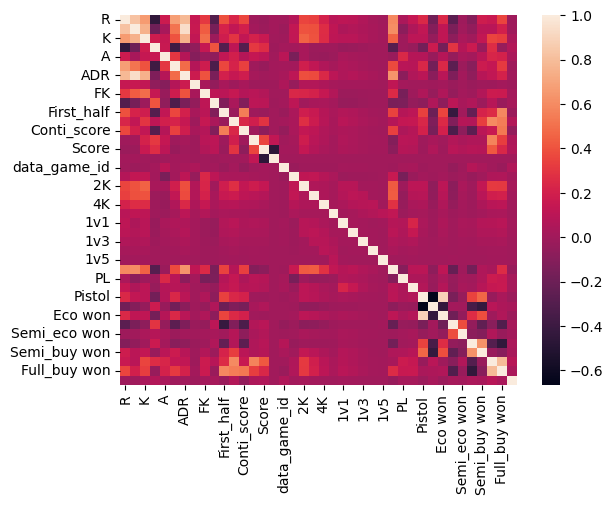

In [ ]:
sns.heatmap(df.corr())

## EDA 할만한거 정리

*   winner와 score에 따른 counts
*   Eco steal 확률이 높으면 승률이 높은가
*   맵마다 유리한 TCT가 있는가
*   Player winner
*   Team winner





### Winner counts

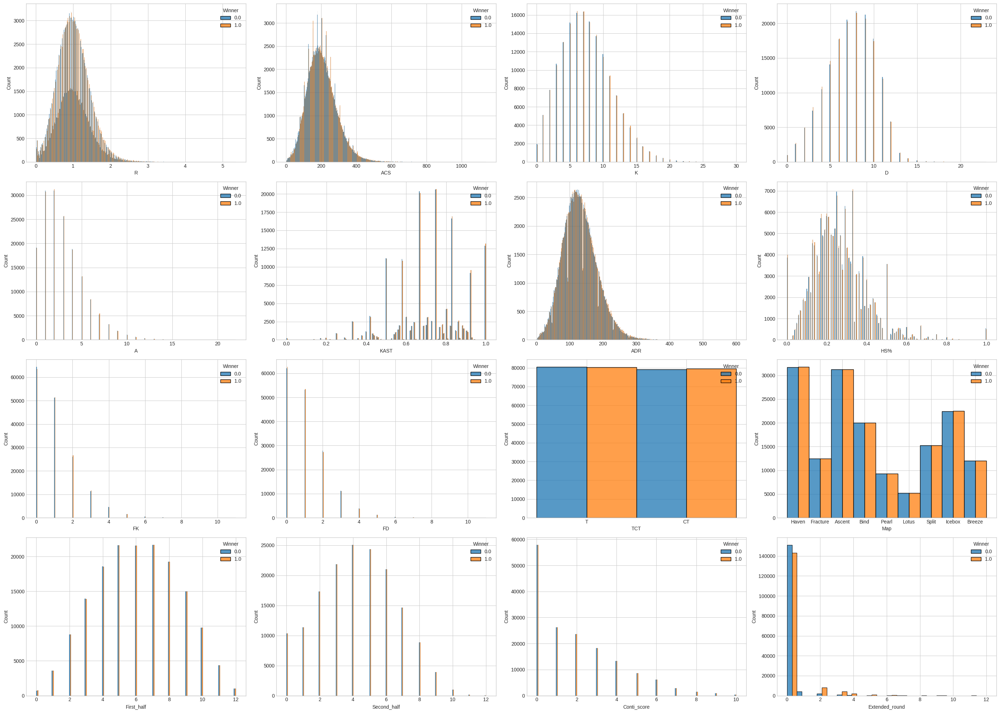

In [ ]:
fig, ax = plt.subplots(4,4)
fig.set_size_inches((28,20))
x1_list = ['R','ACS','K', 'D', 'A', 'KAST', 'ADR','HS%', 'FK', 'FD','TCT', 'Map', 'First_half', 'Second_half', 'Conti_score', 'Extended_round']
for i in range(16):
    row = i//4
    col = i%4
    cur_ax = ax[row, col]
    sns.histplot(data=df, x=x1_list[i],
                      hue='Winner',
                      #hue_order=['Lose', 'Win'],
                      #palette='tab10', ## 컬러맵 지정
                      multiple='dodge', ## 여러 히스토그램 그리는 방식
                      ax=cur_ax,
                     )
plt.tight_layout()

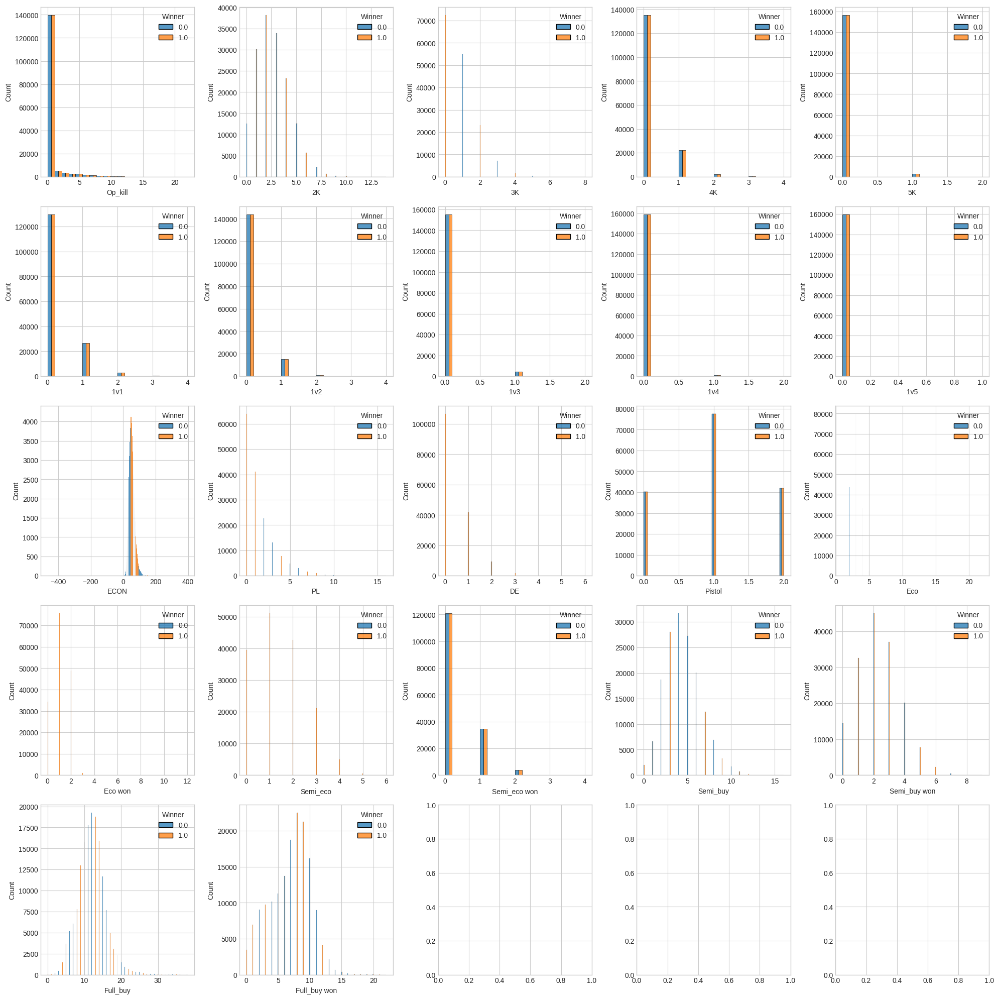

In [ ]:
fig, ax = plt.subplots(5,5)
fig.set_size_inches((20,20))
x2_list = ['Op_kill', '2K', '3K', '4K', '5K', '1v1', '1v2', '1v3', '1v4', '1v5','ECON', 'PL', 'DE', 'Pistol', 'Eco', 'Eco won', 'Semi_eco','Semi_eco won', 'Semi_buy', 'Semi_buy won', 'Full_buy', 'Full_buy won']
for i in range(22):
    row = i//5
    col = i%5
    cur_ax = ax[row, col]
    sns.histplot(data=df, x=x2_list[i],
                      hue='Winner',
                      #hue_order=['Lose', 'Win'],
                      #palette='tab10', ## 컬러맵 지정
                      multiple='dodge', ## 여러 히스토그램 그리는 방식
                      ax=cur_ax,
                     )
plt.tight_layout()

### 맵에 따른 TCT

[(0.0, 0.7)]

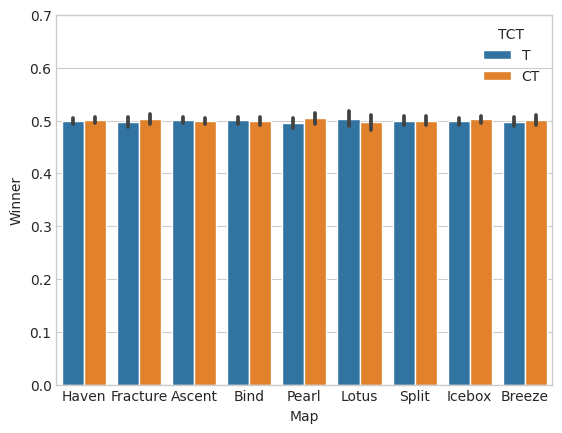

In [ ]:
sns.set_style('whitegrid')
sns.barplot(data=df, x='Map',y='Winner', hue='TCT').set(ylim=(0,0.7))

<Axes: xlabel='Eco won', ylabel='Winner'>

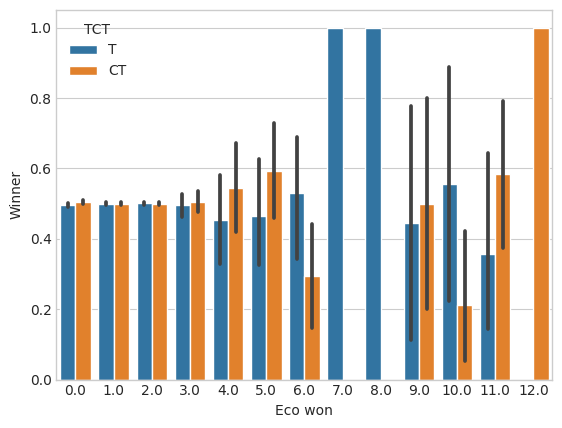

In [ ]:
sns.barplot(data=df, x='Eco won',y='Winner', hue='TCT')

In [ ]:
# 플레이어 승리 횟수 내림차순
df[df['Winner']==1]['Player'].value_counts()[:20]

Ange            269
Crunchy         261
nerve           238
Trick           229
randyySAVAGE    222
Bob             221
Enzo            215
ChurmZ          211
Verno           211
snxper          211
jovahnii        210
Eley            210
Paincakes       209
icy             206
gucc107         200
Rossy           200
zeldris         200
koalanoob       200
iyen            198
Derrek          196
Name: Player, dtype: int64

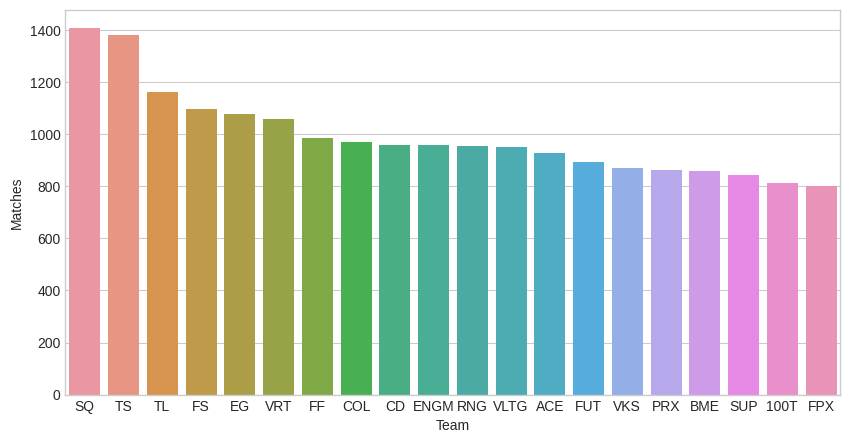

In [ ]:
# 팀 승리 횟수 내림차순
team_win=df[df['Winner']==1]['Team'].value_counts()[:20]
team_win=team_win.reset_index()

plt.figure(figsize=(10, 5))
sns.barplot(x='index',y='Team',data=team_win)
plt.xlabel('Team')
plt.ylabel('Matches')
plt.show()

In [ ]:
sns.pairplot(df[:1000],hue='Winner')
plt.show()

## Player 맵 별 매치 횟수

In [ ]:
df.loc[::-1,:].head()

,Player,Team,VS_Team,R,ACS,K,D,A,KAST,ADR,...,Semi_buy,Semi_buy won,Full_buy,Full_buy won,Date,League,Stage,Patch,BO,Playing_Match
319426,shiba,PRX,RR,0.40,84.0,2.0,9.0,2.0,0.58,66.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319425,shiba,PRX,RR,0.86,206.0,8.0,9.0,0.0,0.42,150.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319424,lenne,PRX,RR,0.81,153.0,7.0,8.0,2.0,0.33,92.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319423,lenne,PRX,RR,0.58,104.0,4.0,9.0,3.0,0.67,68.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319422,Retla,PRX,RR,0.78,251.0,10.0,11.0,1.0,0.67,121.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0


In [ ]:
df_r = df.loc[::-1,:]
#df_r = df_r.drop(['Score','Winner','data_game_id'],axis=1)

In [ ]:
# player_li = list(set(df['Player'].values))
# for i in player_li:
#   map = list(set(df[df['Player']==i]['Map'].values))
#   if len(map) < 5:
#     continue
#   df_play = df[df['Player'] == i].loc[::-1,:]
#   #print(df_play.value_counts())
#   for j in map:
#     print(i,j)
#     print(df_play[df_play['Map']==j][['R', 'ACS', 'K', 'D', 'A', 'KAST', 'ADR',
#        'HS%', 'FK', 'FD', 'First_half', 'Second_half',
#        'Conti_score', 'Extended_round', 'Score', 'Winner',
#        'Op_kill', '2K', '3K', '4K', '5K', '1v1', '1v2', '1v3', '1v4', '1v5',
#        'ECON', 'PL', 'DE', 'Pistol', 'Eco', 'Eco won', 'Semi_eco',
#        'Semi_eco won', 'Semi_buy', 'Semi_buy won', 'Full_buy', 'Full_buy won']].expanding().mean())

In [ ]:
num_col = ['R', 'ACS', 'K', 'D', 'A', 'KAST', 'ADR',
       'HS%', 'FK', 'FD', 'First_half', 'Second_half',
       'Conti_score', 'Extended_round',
       'Op_kill', '2K', '3K', '4K', '5K', '1v1', '1v2', '1v3', '1v4', '1v5',
       'ECON', 'PL', 'DE', 'Pistol', 'Eco', 'Eco won', 'Semi_eco',
       'Semi_eco won', 'Semi_buy', 'Semi_buy won', 'Full_buy', 'Full_buy won']

In [ ]:
df_learn = df_r[num_col].groupby([df_r['Player'],df_r['Map']]).transform(lambda x: x.expanding().mean().shift())

In [ ]:
df_train_na = pd.concat([df_r[['Player','Map','Team','VS_Team','League','Stage','Patch','BO','Playing_Match','Score','Winner','data_game_id']],df_learn],axis=1)

In [ ]:
df_train_na.head()

,Player,Map,Team,VS_Team,League,Stage,Patch,BO,Playing_Match,Score,...,DE,Pistol,Eco,Eco won,Semi_eco,Semi_eco won,Semi_buy,Semi_buy won,Full_buy,Full_buy won
319426,shiba,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
319425,shiba,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
319424,lenne,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
319423,lenne,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,1.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
319422,Retla,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_r.head()

,Player,Team,VS_Team,R,ACS,K,D,A,KAST,ADR,...,Semi_buy,Semi_buy won,Full_buy,Full_buy won,Date,League,Stage,Patch,BO,Playing_Match
319426,shiba,PRX,RR,0.40,84.0,2.0,9.0,2.0,0.58,66.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319425,shiba,PRX,RR,0.86,206.0,8.0,9.0,0.0,0.42,150.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319424,lenne,PRX,RR,0.81,153.0,7.0,8.0,2.0,0.33,92.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319423,lenne,PRX,RR,0.58,104.0,4.0,9.0,3.0,0.67,68.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0
319422,Retla,PRX,RR,0.78,251.0,10.0,11.0,1.0,0.67,121.0,...,7.0,3.0,13.0,6.0,"Saturday, January 30th 2:30 PM KST",Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0


In [ ]:
df_train_ex = df_train_na[df_train_na['Player']=='Derke'].groupby(['Map'])

In [ ]:
print(df_train_ex.get_group('Ascent'))

In [ ]:
df_train = df_train_na.dropna().reset_index(drop=True)

In [ ]:
df_train.head()

,Player,Map,Team,VS_Team,League,Stage,Patch,BO,Playing_Match,Score,...,DE,Pistol,Eco,Eco won,Semi_eco,Semi_eco won,Semi_buy,Semi_buy won,Full_buy,Full_buy won
0,shiba,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
1,lenne,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,1.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
2,Retla,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,1.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
3,FANE,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
4,benaf,Bind,PRX,RR,Champions Tour Malaysia & Singapore Stage 1: C...,Qualifier: Round of 16,Patch 2.01,BO3,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0


In [ ]:
df_train.to_csv('vlr_df_train.csv')

# Label Encoding

In [ ]:
team_name = set(df_train['Team'].values)
vsteam_name = set(df_train['VS_Team'].values)
print(sorted(team_name))
print(sorted(vsteam_name))
print(team_name-vsteam_name)

['0', '100J', '100T', '105', '1234', '123T', '1337', '14VK', '19', '1994', '24H', '2G4L', '2K', '2red', '303', '325', '3E', '3G', '3T', '47', '4D', '4Fun', '4x3', '50k', '5KS', '5M', '5RS', '600', '604', '666', '6K', '7sg', '86', '8P', '95x', '99S', '9z', 'A$AP', 'A3D', 'AA', 'AAA', 'AAS', 'ABA', 'ABL', 'ABX', 'ACE', 'ACT', 'AE', 'AECL', 'AEE', 'AEEC', 'AEP', 'AES', 'AEX', 'AF', 'AG', 'AGG', 'AI', 'AIM', 'AK', 'AKM', 'AKR', 'AKV', 'ALL', 'AMB', 'AME', 'AMG', 'AMT', 'AMZ', 'ANB', 'ANM', 'ANO', 'ANTC', 'AOE', 'AOT', 'APH', 'APK', 'ARCE', 'ARCH', 'AREA', 'ARES', 'ARF', 'ARI', 'ART', 'ARZ', 'ASE', 'ASG', 'ASP', 'ASTR', 'ASV', 'AT', 'ATH', 'ATK', 'ATL', 'ATN', 'AUR', 'AUS', 'AVEZ', 'AVM', 'AVST', 'AWI', 'AWK', 'AX', 'AXI', 'AXL', 'AZN', 'Able', 'AvgJ', 'Ax3', 'AxX', 'B4', 'B8', 'BA', 'BAAM', 'BAL', 'BAR', 'BB', 'BBG', 'BBGA', 'BBI', 'BBL', 'BBP', 'BCG', 'BCR', 'BCS', 'BD', 'BEEX', 'BETA', 'BF', 'BFG', 'BGN', 'BI', 'BIG', 'BIGG', 'BJE', 'BJK', 'BLCK', 'BLD', 'BLG', 'BM', 'BME', 'BNDT', 'BOB'

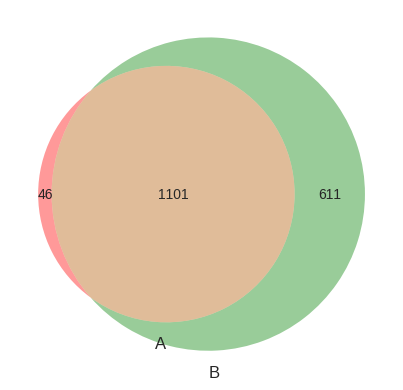

In [ ]:
from matplotlib_venn import venn2

venn2([team_name,vsteam_name])
plt.show()

In [ ]:
my_arr=[]
index=0
for item in df_train.dtypes:
  if(item=='object'):
    my_arr.append(index)
  index=index+1

print(my_arr)
df_train_lb=df_train.values
print('\n============ after encoding =============\n')

lbl=LabelEncoder()
for item in my_arr:
  df_train_lb[:,item] = lbl.fit_transform(df_train_lb[:,item])

print(df_train_lb)

[0, 1, 2, 3, 4, 5, 6, 7]

============ after encoding =============

[[4993 1 754 ... 3.0 13.0 6.0]
 [4414 1 754 ... 3.0 13.0 6.0]
 [2532 1 754 ... 3.0 13.0 6.0]
 ...
 [3900 4 174 ... 3.3333333333333335 12.444444444444445 5.777777777777778]
 [1573 4 174 ... 2.72972972972973 11.216216216216216 7.081081081081081]
 [1573 4 174 ... 2.710526315789474 11.236842105263158 7.052631578947368]]


In [ ]:
df_train_lb = pd.DataFrame(df_train_lb)

In [ ]:
df_train_lb.columns = df_train.columns

In [ ]:
df_train_lb.head()

,Player,Map,Team,VS_Team,League,Stage,Patch,BO,Playing_Match,Score,...,DE,Pistol,Eco,Eco won,Semi_eco,Semi_eco won,Semi_buy,Semi_buy won,Full_buy,Full_buy won
0,4993,1,754,1153,163,767,0,2,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
1,4414,1,754,1153,163,767,0,2,3.0,13.0,...,1.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
2,2532,1,754,1153,163,767,0,2,3.0,13.0,...,1.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
3,907,1,754,1153,163,767,0,2,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0
4,3590,1,754,1153,163,767,0,2,3.0,13.0,...,0.0,2.0,2.0,2.0,2.0,0.0,7.0,3.0,13.0,6.0


# clustering

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
# k에 따라 inertia_(군집 내 거리제곱합의 합)이 어떻게 변하는 지 시각화
def change_n_clusters(n_clusters, data):
    sum_of_squared_distance = []
    for n_cluster in n_clusters:
        kmeans = KMeans(n_clusters=n_cluster)
        kmeans.fit(df_learning)
        sum_of_squared_distance.append(kmeans.inertia_)

    plt.figure(1 , figsize = (12, 6))
    plt.plot(n_clusters , sum_of_squared_distance , 'o')
    plt.plot(n_clusters , sum_of_squared_distance , '-' , alpha = 0.5)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Inertia')


In [ ]:
n_clusters = [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]

In [ ]:
# sacling하지 않은 데이터
# 6 정도가 elbow point로 보인다.
change_n_clusters(n_clusters, df_learning)

KeyboardInterrupt: ignored

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 177, in where
KeyboardInterrupt: 


KeyboardInterrupt: ignored

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 177, in where
KeyboardInterrupt: 


KeyboardInterrupt: ignored

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 177, in where
KeyboardInterrupt: 


KeyboardInterrupt: ignored

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 177, in where
KeyboardInterrupt: 


KeyboardInterrupt: ignored

# ML

In [ ]:
df_train_lb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 290450 entries, 0 to 290449
Data columns (total 48 columns):
 #   Column          Non-Null Count   Dtype 
---  ------          --------------   ----- 
 0   Player          290450 non-null  object
 1   Map             290450 non-null  object
 2   Team            290450 non-null  object
 3   VS_Team         290450 non-null  object
 4   League          290450 non-null  object
 5   Stage           290450 non-null  object
 6   Patch           290450 non-null  object
 7   BO              290450 non-null  object
 8   Playing_Match   290450 non-null  object
 9   Score           290450 non-null  object
 10  Winner          290450 non-null  int64 
 11  data_game_id    290450 non-null  object
 12  R               290450 non-null  object
 13  ACS             290450 non-null  object
 14  K               290450 non-null  object
 15  D               290450 non-null  object
 16  A               290450 non-null  object
 17  KAST            290450 non-nu

In [ ]:
df_train_lb['Winner'] = df_train_lb['Winner'].astype('int')

## Train Test Split

In [ ]:
from sklearn.model_selection import train_test_split

X = df_train_lb.drop(['Winner','Score'], axis=1)
y = df_train_lb.Winner

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

## Decision Trees

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_train, pred)}\n")

    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:\n================================================")
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_test, pred)}\n")

In [ ]:
from sklearn.tree import DecisionTreeClassifier

tree_clf = DecisionTreeClassifier(random_state=42)
tree_clf.fit(X_train, y_train)

print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

Train Result:
Accuracy Score: 99.97%
_______________________________________________
CLASSIFICATION REPORT:
                       0              1  accuracy      macro avg  \
precision       0.999470       1.000000  0.999732       0.999735   
recall          1.000000       0.999459  0.999732       0.999730   
f1-score        0.999735       0.999730  0.999732       0.999732   
support    131946.000000  129459.000000  0.999732  261405.000000   

            weighted avg  
precision       0.999732  
recall          0.999732  
f1-score        0.999732  
support    261405.000000  
_______________________________________________
Confusion Matrix: 
 [[131946      0]
 [    70 129389]]

Test Result:
Accuracy Score: 55.08%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy     macro avg  weighted avg
precision      0.558610      0.542952  0.550835      0.550781      0.550909
recall         0.553388      0.548197  0.550835      

## RandomForest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rf_clf = RandomForestClassifier(n_estimators=300)
rf_clf.fit(X_train, y_train)

print_score(rf_clf, X_train, y_train, X_test, y_test, train=True)
print_score(rf_clf, X_train, y_train, X_test, y_test, train=False)

Train Result:
Accuracy Score: 99.97%
_______________________________________________
CLASSIFICATION REPORT:
                       0              1  accuracy      macro avg  \
precision       0.999727       0.999737  0.999732       0.999732   
recall          0.999742       0.999722  0.999732       0.999732   
f1-score        0.999735       0.999730  0.999732       0.999732   
support    131946.000000  129459.000000  0.999732  261405.000000   

            weighted avg  
precision       0.999732  
recall          0.999732  
f1-score        0.999732  
support    261405.000000  
_______________________________________________
Confusion Matrix: 
 [[131912     34]
 [    36 129423]]

Test Result:
Accuracy Score: 33.57%
_______________________________________________
CLASSIFICATION REPORT:
                      0             1  accuracy     macro avg  weighted avg
precision      0.351208      0.318633   0.33572      0.334920      0.335187
recall         0.362534      0.308015   0.33572      

### Grid Search

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV

n_estimators = [100, 500, 1000, 1500]
max_features = ['auto', 'sqrt']
max_depth = [2, 3, 5]
max_depth.append(None)
min_samples_split = [2, 5, 10]
min_samples_leaf = [1, 2, 4, 10]
bootstrap = [True, False]

params_grid = {
    'n_estimators': n_estimators,
    'max_features': max_features,
    'max_depth': max_depth,
    'min_samples_split': min_samples_split,
    'min_samples_leaf': min_samples_leaf,
    'bootstrap': bootstrap
}

rf_clf = RandomForestClassifier(random_state=42)

rf_cv = GridSearchCV(
    rf_clf,
    params_grid,
    scoring="f1",
    cv=5,
    verbose=1,
    n_jobs=-1
)


rf_cv.fit(X_train, y_train)
best_params = rf_cv.best_params_
print(f"Best parameters: {best_params}")

rf_clf = RandomForestClassifier(**best_params)
rf_clf.fit(X_train, y_train)

print_score(rf_clf, X_train, y_train, X_test, y_test, train=True)
print_score(rf_clf, X_train, y_train, X_test, y_test, train=False)

Fitting 5 folds for each of 768 candidates, totalling 3840 fits


KeyboardInterrupt: ignored

## XGB LGB CAT

In [ ]:
!pip install catboost

In [ ]:
X_train = X_train.values
y_train = y_train.values
X_test = X_test.values
y_test = y_test.values

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
import xgboost as xgb
import lightgbm as lgb
import catboost as cb

kfold = KFold(n_splits=5, shuffle=True, random_state=42)

In [ ]:
def kfold_cross_validation(X, y, model_type='xgboost', params=None):
    models = []
    scores = []

    for train_idx, val_idx in kfold.split(X, y):
        X_train, X_val = X[train_idx], X[val_idx]
        y_train, y_val = y[train_idx], y[val_idx]

        if model_type == 'xgboost':
            model = xgb.XGBClassifier(**params)
        elif model_type == 'lightgbm':
            model = lgb.LGBMClassifier(**params)
        elif model_type == 'catboost':
            model = cb.CatBoostClassifier(**params, verbose=False)
        else:
            raise ValueError("Invalid model_type. Use 'xgboost', 'lightgbm', or 'catboost'.")

        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)
        score = accuracy_score(y_val, y_pred)

        models.append(model)
        scores.append(score)

    return models, scores


In [ ]:
xgb_params = {'objective': 'binary:logistic', 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 100}
lgb_params = {'objective': 'binary', 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 100}
cat_params = {'loss_function': 'Logloss', 'learning_rate': 0.05, 'max_depth': 5, 'n_estimators': 100}

In [ ]:
xgb_models, xgb_scores = kfold_cross_validation(X_train, y_train, model_type='xgboost', params=xgb_params)
lgb_models, lgb_scores = kfold_cross_validation(X_train, y_train, model_type='lightgbm', params=lgb_params)
cat_models, cat_scores = kfold_cross_validation(X_train, y_train, model_type='catboost', params=cat_params)

In [ ]:
print("XGBoost Accuracy:", xgb_scores)
print("LightGBM Accuracy:", lgb_scores)
print("CatBoost Accuracy:", cat_scores)

XGBoost Accuracy: [0.5238996958742181, 0.5291788603890515, 0.5226181595608347, 0.5278590692603431, 0.525850691455787]
LightGBM Accuracy: [0.52650102331631, 0.5261758573860484, 0.5221591017769361, 0.5264818959086475, 0.525506398117863]
CatBoost Accuracy: [0.5161339683632677, 0.5187735506206844, 0.5146420305655974, 0.5182762380214609, 0.5203037432336796]


In [ ]:
xgb_test_preds = [model.predict(X_test) for model in xgb_models]
xgb_test_accuracy = accuracy_score(y_test, np.round(np.mean(xgb_test_preds, axis=0)))

lgb_test_preds = [model.predict(X_test) for model in lgb_models]
lgb_test_accuracy = accuracy_score(y_test, np.round(np.mean(lgb_test_preds, axis=0)))

cat_test_preds = [model.predict(X_test) for model in cat_models]
cat_test_accuracy = accuracy_score(y_test, np.round(np.mean(cat_test_preds, axis=0)))

print("\nXGBoost Test Accuracy:", xgb_test_accuracy)
print("LightGBM Test Accuracy:", lgb_test_accuracy)
print("CatBoost Test Accuracy:", cat_test_accuracy)


XGBoost Test Accuracy: 0.5292821483904286
LightGBM Test Accuracy: 0.530728180409709
CatBoost Test Accuracy: 0.5192632122568428


In [ ]:
# 테스트 데이터셋에 대한 혼동 행렬과 분류 보고서 출력
def display_confusion_matrix_and_classification_report(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    cm_df = pd.DataFrame(cm, columns=['Predicted Negative', 'Predicted Positive'], index=['True Negative', 'True Positive'])
    print("Confusion Matrix:")
    print(cm_df)

    print("\nClassification Report:")
    print(classification_report(y_true, y_pred))

# 각 모델들의 정확도 (퍼센티지) 출력
def display_accuracy_percentage(accuracy):
    print(f"Accuracy: {accuracy*100:.2f}%")


print("\nXGBoost Confusion Matrix and Classification Report:")
xgb_test_pred_avg = np.round(np.mean(xgb_test_preds, axis=0))
display_confusion_matrix_and_classification_report(y_test, xgb_test_pred_avg)

print("\nXGBoost Accuracy:")
display_accuracy_percentage(xgb_test_accuracy)

print("\nLightGBM Confusion Matrix and Classification Report:")
lgb_test_pred_avg = np.round(np.mean(lgb_test_preds, axis=0))
display_confusion_matrix_and_classification_report(y_test, lgb_test_pred_avg)

print("\nLightGBM Accuracy:")
display_accuracy_percentage(lgb_test_accuracy)

print("\nCatBoost Confusion Matrix and Classification Report:")
cat_test_pred_avg = np.round(np.mean(cat_test_preds, axis=0))
display_confusion_matrix_and_classification_report(y_test, cat_test_pred_avg)

print("\nCatBoost Accuracy:")
display_accuracy_percentage(cat_test_accuracy)


XGBoost Confusion Matrix and Classification Report:
Confusion Matrix:
               Predicted Negative  Predicted Positive
True Negative                8624                6136
True Positive                7536                6749

Classification Report:
              precision    recall  f1-score   support

           0       0.53      0.58      0.56     14760
           1       0.52      0.47      0.50     14285

    accuracy                           0.53     29045
   macro avg       0.53      0.53      0.53     29045
weighted avg       0.53      0.53      0.53     29045


XGBoost Accuracy:
Accuracy: 52.93%

LightGBM Confusion Matrix and Classification Report:
Confusion Matrix:
               Predicted Negative  Predicted Positive
True Negative                8578                6182
True Positive                7448                6837

Classification Report:
              precision    recall  f1-score   support

           0       0.54      0.58      0.56     14760
           1 

# 아이디어

  * *날짜순대로 나열 후 각 Stat의 평균값을 학습*
  * 맵별 평균값 or 팀별 평균값 or 최빈값 or 가중 평균(시간순 가중)
  * 시계열 딥러닝
  * 플레이어 통계 스탯과 승률 -> 팀 승률 예측

  플레이어 스탯도 예측 가능?